In [24]:
!pip install -qq -U diffusers==0.11.1 transformers ftfy gradio accelerate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 93.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 80.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.6/227.6 kB 27.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 45.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 81.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 78.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 288.3/288.3 kB 36.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.4/75.4 kB 11.0 MB/s eta 0:00:

In [25]:
from huggingface_hub import notebook_login

notebook_login()

In [26]:
import inspect
from typing import List, Optional, Union

import numpy as np
import torch

import PIL
import gradio as gr
from diffusers import StableDiffusionInpaintPipeline

In [27]:
device = "cuda"
model_path = "stabilityai/stable-diffusion-2-inpainting"

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    model_path,
    torch_dtype=torch.float16,
).to(device)

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

In [28]:
import requests
from io import BytesIO

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = PIL.Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

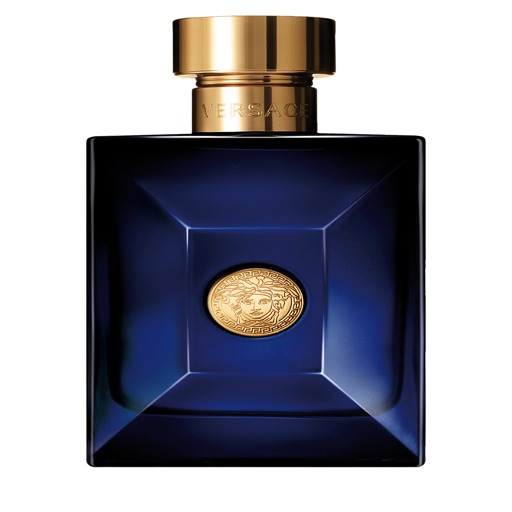

In [101]:
image = PIL.Image.open('/content/perfume-png-transparent-images-png-only-12.png').convert("RGB").resize((512, 512))
image

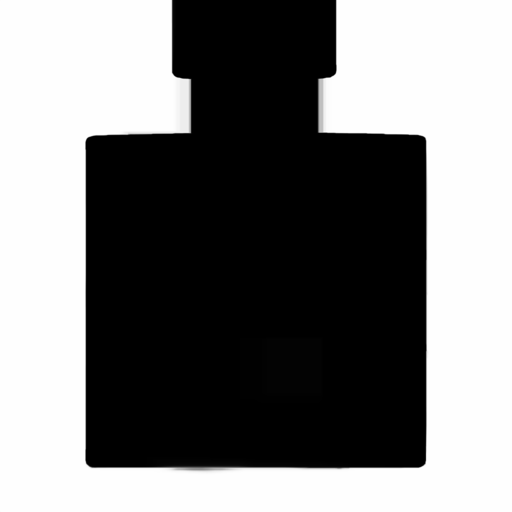

In [102]:
mask_image = PIL.Image.open('/content/enhanced_mask_image.png').convert("RGB").resize((512, 512))
mask_image

In [98]:
prompt = "Create a realistic portrait photo of a white marble table counter against pink walls. Shot with a DSLR, the image should have natural shadows, abundant natural light, and be sharp and in focus. Please ensure a 4K resolution, capturing the fine details and textures of the marble. The composition should be visually pleasing, highlighting the contrast between the white marble and pink walls."
guidance_scale=2.5
num_samples = 3
generator = torch.Generator(device="cuda").manual_seed(0) # change the seed to get different results

images = pipe(
    prompt=prompt,
    image=image,
    mask_image=mask_image,
    guidance_scale=guidance_scale,
    generator=generator,
    num_images_per_prompt=num_samples,
).images

  0%|          | 0/50 [00:00<?, ?it/s]

In [99]:
# insert initial image in the list so we can compare side by side
images.insert(0, image)

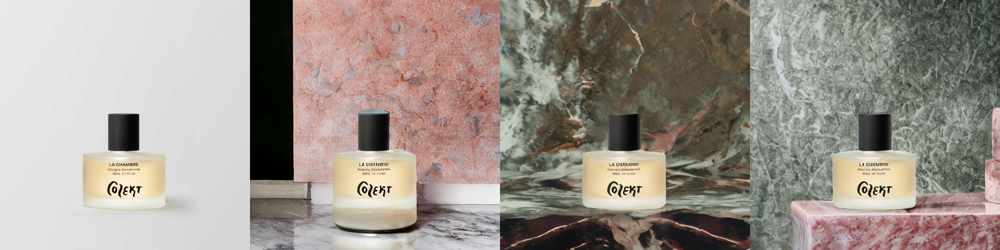

In [104]:
#prompt = "Create a realistic portrait photo of a white marble table counter against pink walls. Shot with a DSLR, the image should have natural shadows, abundant natural light, and be sharp and in focus. Please ensure a 4K resolution, capturing the fine details and textures of the marble. The composition should be visually pleasing, highlighting the contrast between the white marble and pink walls."
image_grid(images, 1, num_samples + 1)

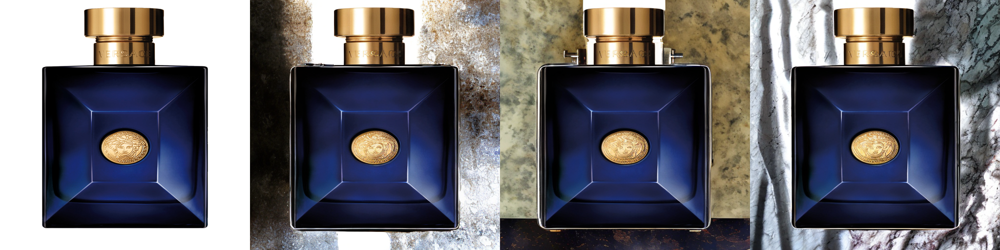

In [93]:
#prompt = "Create a realistic portrait photo of a white marble table counter against pink walls. Shot with a DSLR, the image should have natural shadows, abundant natural light, and be sharp and in focus. Please ensure a 4K resolution, capturing the fine details and textures of the marble. The composition should be visually pleasing, highlighting the contrast between the white marble and pink walls."
#paraphrased version
image_grid(images, 1, num_samples + 1)

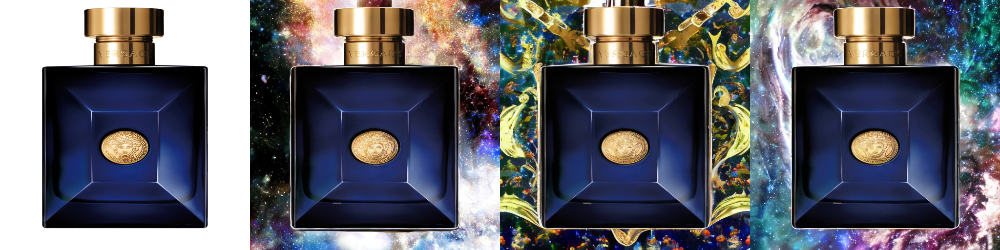

In [56]:
#prompt = "Surround the perfume bottle with breathtaking nebulas and distant galaxies. Use vibrant colors, such as deep purples, blues, pinks, and golds, to create a celestial spectacle. These cosmic formations should add depth and cosmic grandeur to the scene."
image_grid(images, 1, num_samples + 1)

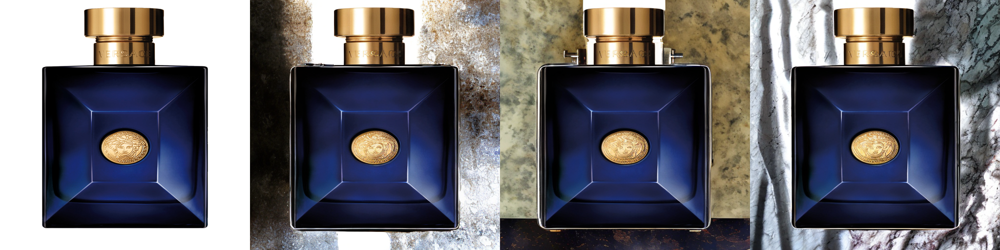

In [94]:
#prompt = "a portrait photo of a white marble table counter with pink walls background, dslr, natural shadow, natural light, sharp, in focus, 4k"
#enhanced mask version
image_grid(images, 1, num_samples + 1)

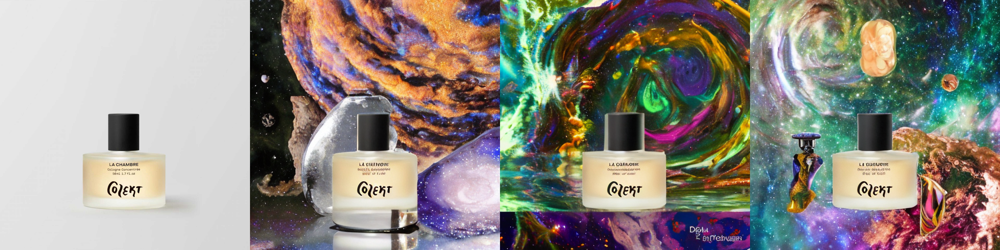

In [ ]:
image_grid(images, 1, num_samples + 1)

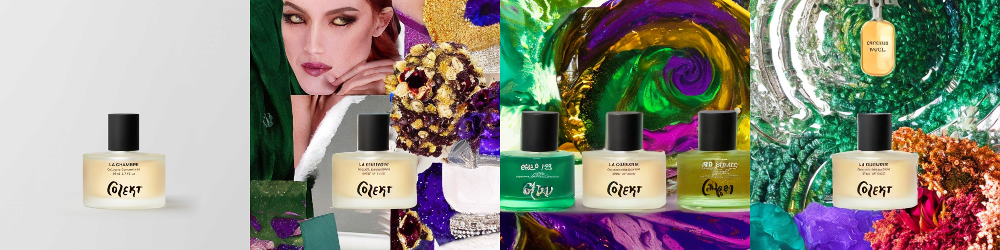

In [ ]:
image_grid(images, 1, num_samples + 1)

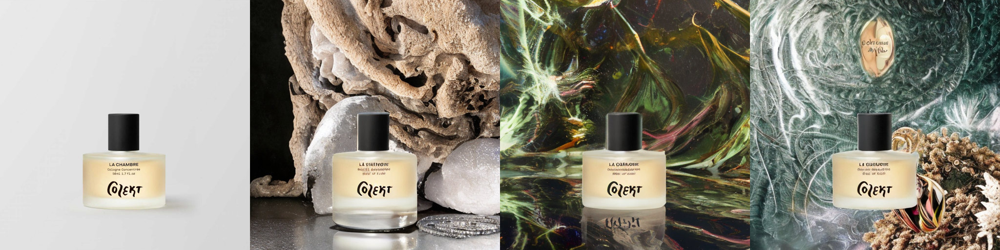

In [ ]:
image_grid(images, 1, num_samples + 1)

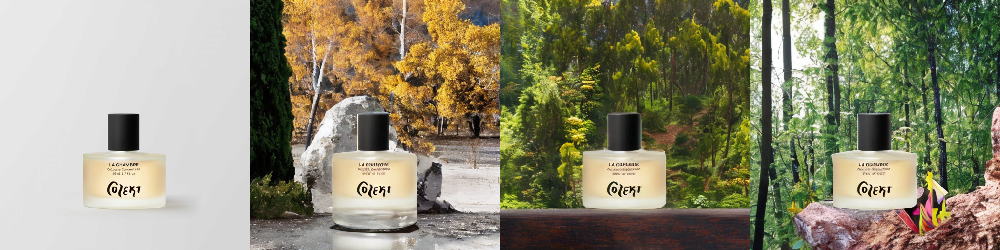

In [ ]:
image_grid(images, 1, num_samples + 1)

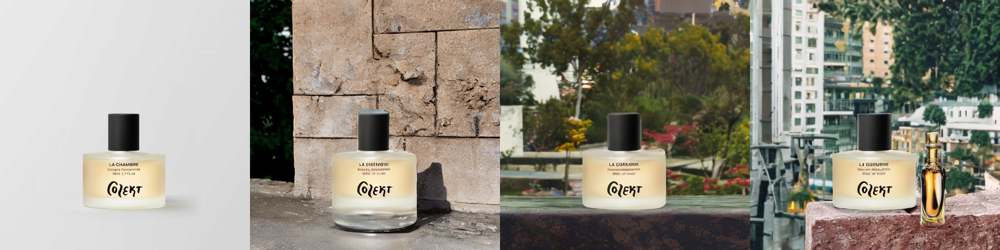

In [ ]:
image_grid(images, 1, num_samples + 1)

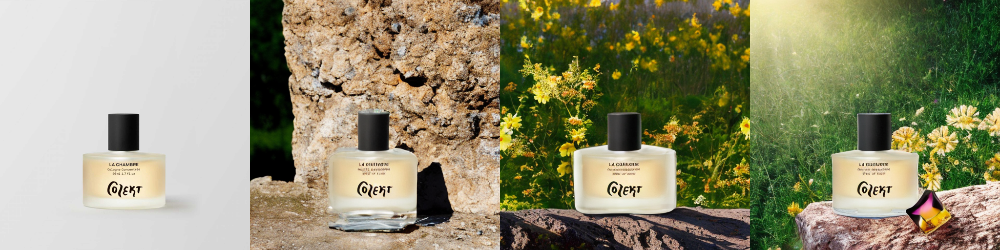

In [ ]:
image_grid(images, 1, num_samples + 1)

In [43]:
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-2-inpainting",
    torch_dtype=torch.float16,
)
pipe.to("cuda")

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

StableDiffusionInpaintPipeline {
  "_class_name": "StableDiffusionInpaintPipeline",
  "_diffusers_version": "0.11.1",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [46]:
prompt = "a portrait photo of a white marble table counter with pink walls background, dslr, natural shadow, natural light, sharp, in focus, 4k"
#image and mask_image should be PIL images.
#The mask structure is white for inpainting and black for keeping as is
image = pipe(prompt=prompt, image=image, mask_image=mask_image).images[0]
image.save("/content/design.png")

  0%|          | 0/50 [00:00<?, ?it/s]

In [1]:
!git clone https://github.com/xuebinqin/DIS

%cd ./DIS/IS-Net

!pip install gdown

Cloning into 'DIS'...
remote: Enumerating objects: 328, done.
remote: Counting objects: 100% (94/94), done.
remote: Compressing objects: 100% (27/27), done.
remote: Total 328 (delta 80), reused 67 (delta 67), pack-reused 234
Receiving objects: 100% (328/328), 49.59 MiB | 37.09 MiB/s, done.
Resolving deltas: 100% (156/156), done.
/content/DIS/IS-Net
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import numpy as np
from PIL import Image
import torch
from torch.autograd import Variable
from torchvision import transforms
import torch.nn.functional as F
import gdown
import os

import requests
import matplotlib.pyplot as plt
from io import BytesIO

# project imports
from data_loader_cache import normalize, im_reader, im_preprocess
from models import *

/usr/local/lib/python3.10/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


In [3]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Download official weights
if not os.path.exists("./saved_models"):
    !mkdir ./saved_models
    MODEL_PATH_URL = "https://drive.google.com/uc?id=1KyMpRjewZdyYfxHPYcd-ZbanIXtin0Sn"
    gdown.download(MODEL_PATH_URL, "./saved_models/isnet.pth", use_cookies=False)


class GOSNormalize(object):
    '''
    Normalize the Image using torch.transforms
    '''
    def __init__(self, mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225]):
        self.mean = mean
        self.std = std

    def __call__(self,image):
        image = normalize(image,self.mean,self.std)
        return image


transform =  transforms.Compose([GOSNormalize([0.5,0.5,0.5],[1.0,1.0,1.0])])

def load_image(im_path, hypar):
    if im_path.startswith("http"):
        im_path = BytesIO(requests.get(im_path).content)

    im = im_reader(im_path)
    im, im_shp = im_preprocess(im, hypar["cache_size"])
    im = torch.divide(im,255.0)
    shape = torch.from_numpy(np.array(im_shp))
    return transform(im).unsqueeze(0), shape.unsqueeze(0) # make a batch of image, shape


def build_model(hypar,device):
    net = hypar["model"]#GOSNETINC(3,1)

    # convert to half precision
    if(hypar["model_digit"]=="half"):
        net.half()
        for layer in net.modules():
            if isinstance(layer, nn.BatchNorm2d):
                layer.float()

    net.to(device)

    if(hypar["restore_model"]!=""):
        net.load_state_dict(torch.load(hypar["model_path"]+"/"+hypar["restore_model"],map_location=device))
        net.to(device)
    net.eval()
    return net


def predict(net,  inputs_val, shapes_val, hypar, device):
    '''
    Given an Image, predict the mask
    '''
    net.eval()

    if(hypar["model_digit"]=="full"):
        inputs_val = inputs_val.type(torch.FloatTensor)
    else:
        inputs_val = inputs_val.type(torch.HalfTensor)


    inputs_val_v = Variable(inputs_val, requires_grad=False).to(device) # wrap inputs in Variable

    ds_val = net(inputs_val_v)[0] # list of 6 results

    pred_val = ds_val[0][0,:,:,:] # B x 1 x H x W    # we want the first one which is the most accurate prediction

    ## recover the prediction spatial size to the orignal image size
    pred_val = torch.squeeze(F.upsample(torch.unsqueeze(pred_val,0),(shapes_val[0][0],shapes_val[0][1]),mode='bilinear'))

    ma = torch.max(pred_val)
    mi = torch.min(pred_val)
    pred_val = (pred_val-mi)/(ma-mi) # max = 1

    if device == 'cuda': torch.cuda.empty_cache()
    return (pred_val.detach().cpu().numpy()*255).astype(np.uint8) # it is the mask we need

Downloading...
From: https://drive.google.com/uc?id=1KyMpRjewZdyYfxHPYcd-ZbanIXtin0Sn
To: /content/DIS/IS-Net/saved_models/isnet.pth
100%|██████████| 177M/177M [00:06<00:00, 29.1MB/s]


In [4]:
hypar = {} # paramters for inferencing


hypar["model_path"] ="./saved_models" ## load trained weights from this path
hypar["restore_model"] = "isnet.pth" ## name of the to-be-loaded weights
hypar["interm_sup"] = False ## indicate if activate intermediate feature supervision

##  choose floating point accuracy --
hypar["model_digit"] = "full" ## indicates "half" or "full" accuracy of float number
hypar["seed"] = 0

hypar["cache_size"] = [1024, 1024] ## cached input spatial resolution, can be configured into different size

## data augmentation parameters ---
hypar["input_size"] = [1024, 1024] ## mdoel input spatial size, usually use the same value hypar["cache_size"], which means we don't further resize the images
hypar["crop_size"] = [1024, 1024] ## random crop size from the input, it is usually set as smaller than hypar["cache_size"], e.g., [920,920] for data augmentation

hypar["model"] = ISNetDIS()

In [5]:
net = build_model(hypar, device)

In [10]:
from PIL import Image

# Open the image file
image_path = "/content/perfume-png-transparent-images-png-only-12.png"
image = Image.open(image_path)

# Get the shape of the image
width, height = image.size
channels = len(image.getbands())

print("Image shape:", width, "x", height, "x", channels)

Image shape: 1425 x 2000 x 4


In [11]:
from PIL import Image

# Open the image file
image_path = "/content/200630_colekt_pack0937__la_chambre__bottle_50ml__final__16x9-copy-scaled.jpg"
image = Image.open(image_path)

# Get the shape of the image
width, height = image.size
channels = len(image.getbands())

print("Image shape:", width, "x", height, "x", channels)

Image shape: 1920 x 1920 x 3


In [14]:
from PIL import Image

# Open the image file
image_path = "/content/perfume-png-transparent-images-png-only-12.png"
image = Image.open(image_path)

# Resize the image
target_size = (1920, 1920)
resized_image = image.resize(target_size)

# Convert image to RGB
rgb_image = resized_image.convert("RGB")

# Get the transformed shape
width, height = rgb_image.size
channels = len(rgb_image.getbands())

# Save the RGB image
output_path = "/content/transformed_image.jpg"
rgb_image.save(output_path)

print("Transformed Image shape:", width, "x", height, "x", channels)

Transformed Image shape: 1920 x 1920 x 3


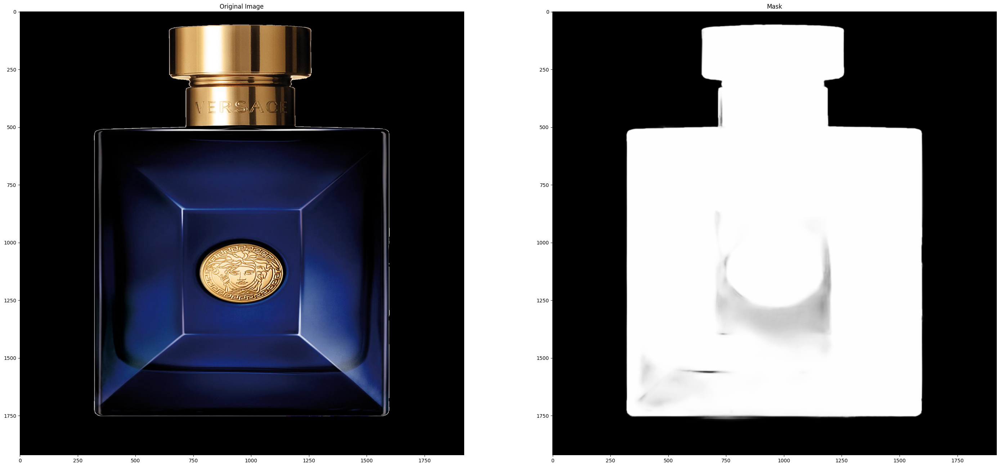

In [15]:
image_path = "/content/transformed_image.jpg"
#image_bytes = BytesIO(requests.get(image_path).content)

image_tensor, orig_size = load_image(image_path, hypar)
mask = predict(net,image_tensor,orig_size, hypar, device)

f, ax = plt.subplots(1,2, figsize = (35,20))

ax[0].imshow(np.array(Image.open(image_path))) # Original image
ax[1].imshow(mask, cmap = 'gray') # retouched image

ax[0].set_title("Original Image")
ax[1].set_title("Mask")

plt.show()

In [18]:
import os
import time
import numpy as np
from skimage import io
import time
from glob import glob
from tqdm import tqdm

import torch, gc
import torch.nn as nn
from torch.autograd import Variable
import torch.optim as optim
import torch.nn.functional as F
from torchvision.transforms.functional import normalize

import sys
sys.path.append('/content/DIS/IS-Net')

from models import *

In [20]:
model_path="/content/DIS/IS-Net/saved_models/isnet.pth"  # the model path
result_path="/content/result-bg"
input_size=[1024,1024]
net=ISNetDIS()

In [21]:
if torch.cuda.is_available():
    net.load_state_dict(torch.load(model_path))
    net=net.cuda()
else:
    net.load_state_dict(torch.load(model_path,map_location="cpu"))
net.eval()

ISNetDIS(
  (conv_in): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (pool_in): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
  (stage1): RSU7(
    (rebnconvin): REBNCONV(
      (conv_s1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn_s1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu_s1): ReLU(inplace=True)
    )
    (rebnconv1): REBNCONV(
      (conv_s1): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn_s1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu_s1): ReLU(inplace=True)
    )
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (rebnconv2): REBNCONV(
      (conv_s1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn_s1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu_s1): ReL

In [60]:
im_path = '/content/200630_colekt_pack0937__la_chambre__bottle_50ml__final__16x9-copy-scaled.jpg'

In [61]:
with torch.no_grad():
    print("im_path: ", im_path)
    im = io.imread(im_path)
    if len(im.shape) < 3:
        im = im[:, :, np.newaxis]
    im_shp=im.shape[0:2]
    im_tensor = torch.tensor(im, dtype=torch.float32).permute(2,0,1)
    im_tensor = F.upsample(torch.unsqueeze(im_tensor,0), input_size, mode="bilinear").type(torch.uint8)
    image = torch.divide(im_tensor,255.0)
    image = normalize(image,[0.5,0.5,0.5],[1.0,1.0,1.0])
    if torch.cuda.is_available():
        image=image.cuda()
    result=net(image)
    result=torch.squeeze(F.upsample(result[0][0],im_shp,mode='bilinear'),0)
    ma = torch.max(result)
    mi = torch.min(result)
    result = (result-mi)/(ma-mi)
    # Invert the object mask
    result = 1 - result
    im_name = im_path.split('/')[-1].split('.')[0]
    io.imsave(os.path.join(result_path, im_name + ".png"), (result * 255).permute(1, 2, 0).cpu().data.numpy().astype(np.uint8))

im_path:  /content/200630_colekt_pack0937__la_chambre__bottle_50ml__final__16x9-copy-scaled.jpg


# Enhancing Mask: Image Processing Technique

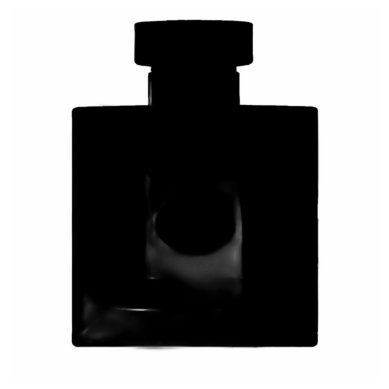

In [80]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def enhance_black_regions(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_mask = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    enhanced_image = cv2.bitwise_and(image, image, mask=binary_mask)
    return enhanced_image

predicted_mask = cv2.imread('/content/result-bg/transformed_image.png')
enhanced_mask = enhance_black_regions(predicted_mask)
enhanced_mask_rgb = cv2.cvtColor(enhanced_mask, cv2.COLOR_BGR2RGB)

plt.imshow(enhanced_mask_rgb)
plt.axis('off')
plt.show()

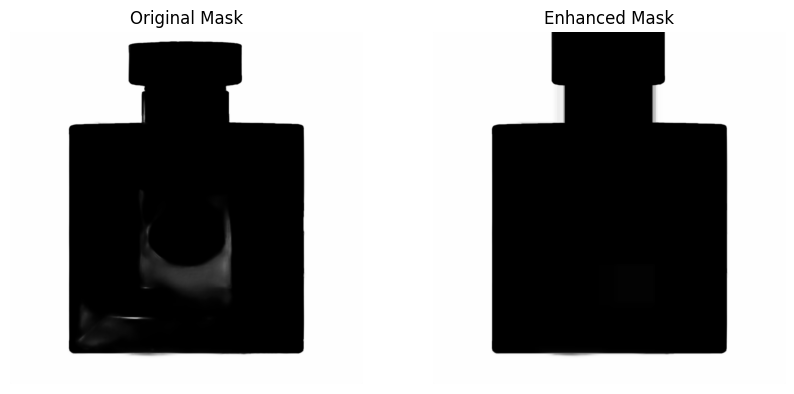

In [86]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load the mask image
mask = cv2.imread('/content/result-bg/transformed_image.png')

# Convert the image to grayscale
gray = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

# Apply morphological operations
kernel = np.ones((3,3), np.uint8)
eroded = cv2.erode(gray, kernel, iterations=100)
dilated = cv2.dilate(eroded, kernel, iterations=100)

# Convert back to BGR
mask_enhanced = cv2.cvtColor(dilated, cv2.COLOR_GRAY2BGR)

# Create a figure and display the original mask image and the enhanced mask image
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(cv2.cvtColor(mask, cv2.COLOR_BGR2RGB))
axs[0].set_title('Original Mask')
axs[0].axis('off')

axs[1].imshow(cv2.cvtColor(mask_enhanced, cv2.COLOR_BGR2RGB))
axs[1].set_title('Enhanced Mask')
axs[1].axis('off')

plt.show()

In [88]:
cv2.imwrite('/content/enhanced_mask_image.png', mask_enhanced)
print("Enhanced mask image saved successfully.")

Enhanced mask image saved successfully.
